# Self-Driving Car Engineer Nanodegree


## Project: Advanced Lane Lines 
***
In this project, We will use Advanced vision techniques are applieed to find lane Lines.  

This template is a modified version of the P1 FindLane Lines template. 

The write will be a PDF and follow the Rubrics points at link: https://review.udacity.com/#!/rubrics/1966/view . 

I will demostrate the following: 

1) Camera Calibration of multiple images  9x6 checkerboard

2) Perspective transform

3) Pipeline Test Images

4) Identify where lane-line pixels and their fit to a polynomial

5) Calculate the Radius of Curviature 

6) Provide an example onto the road such that the lane area is identified clearly 

7) Display a Pipeline Video 

8) Provide a write up of the steps taken along with discussion on Problems/Issue and where additional issues may arise 

---

## Import Packages

In [1]:
#importing some useful packages
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
import cv2
import pickle
import glob
#%matplotlib qt



## Camera Calibration

Text(0.5, 1.0, 'Undistorted Image')

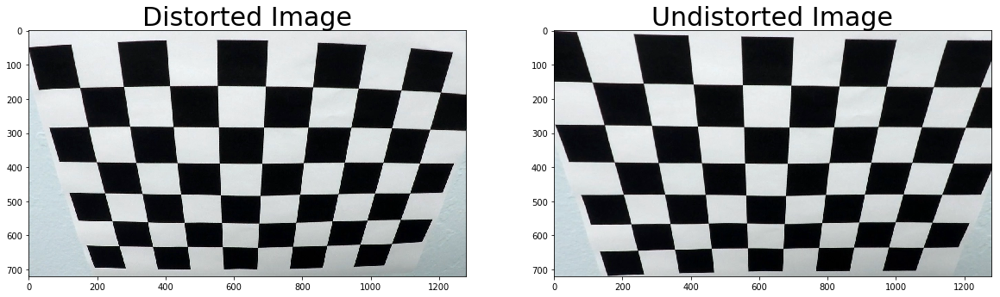

In [2]:
# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('./camera_cal/calibration*.jpg')

#index for saving images with chess board corners drawn
idx=0
# Step through the list and search for chessboard corners
for fname in images:
    
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (9,6),None)
    
    # If found, add points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)
        
        # Draw and Display
        img = cv2.drawChessboardCorners(img, (9,6), corners, ret)
        cv2.imshow('img',img)
        cv2.waitKey(500)
        idx+=1

# Comment next line to keep chess corner image open
cv2.destroyAllWindows()



#%matplotlib inline

# Test undistortion on an image
img = cv2.imread('./camera_cal/calibration2.jpg')
img_size = (img.shape[1], img.shape[0])

# Camera calibration on Object and Image points
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size,None,None)


undst = cv2.undistort(img, mtx, dist, None, mtx)
cv2.imwrite('undist_cal2.jpg',dist)

# Save camera calibration 
dist_pickle = {}
dist_pickle["mtx"] = mtx
dist_pickle["dist"] = dist
pickle.dump( dist_pickle, open( "./camera_cal/wide_dist_pickle.p", "wb" ) )

# Visualize undistortion
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
ax1.imshow(img)
ax1.set_title('Distorted Image', fontsize=30)
ax2.imshow(undst)
ax2.set_title('Undistorted Image', fontsize=30)

## Helper Functions

Functions

In [3]:
import math
import pickle

def process_image(image):
    # process image
    #Read in Camera Calibration Matrix
    dist_pickle = pickle.load( open( "./camera_cal/wide_dist_pickle.p", "rb" ) )
    mtx = dist_pickle["mtx"]
    dist = dist_pickle["dist"]
    
    #Undistort after converstion to RGB
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    undistort_img = undistort(image, mtx, dist)

    # Color and Gradient Thresholding
    kernel=9
    soblelx_thresh =(20,255)
    hls_s_thresh =(120,255)
    lab_b_thresh =(155,225)
    lab_l_thresh=(40,255)
    binary=bin_threshold(undistort_img,kernel=kernel,binx_thresh=soblelx_thresh,s_thresh=hls_s_thresh,b_thresh=lab_b_thresh,l_thresh=lab_l_thresh)
    
    #Perspective Transform
    source=np.float32([[710,450],[1150,720],[230,720],[600,450]])#Test 1 image
    pers_bin_img,Minv=persp_transform(binary,source)
    warp_img,Minv=persp_transform(img,source)
    
    ## Recognizing lane lines through sliding window implementation
    plot=False
    left_fit, right_fit, left_lane_inds, right_lane_inds, histogram = sliding_window_polyfit(pers_bin_img,plot)
    
    #Determine radius of curvature
    left_curv, right_curv, cent_dist = rad_curvature(pers_bin_img, left_fit, right_fit, left_lane_inds, right_lane_inds)
       
    #Draw the lane lines and output radius of curvature information on image
    result = draw_lane(undistort_img, pers_bin_img, left_fit, right_fit, Minv,left_curv,right_curv,cent_dist) 
    result = cv2.cvtColor(result, cv2.COLOR_BGR2RGB)
    return result

def rad_curvature(img, left_fit, right_fit, left_lane_inds, right_lane_inds):
    left_curverad, right_curverad, center_dist = (0, 0, 0)
    
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    
    x= img.shape[0]
    ploty = np.linspace(0, x-1, x)
    y_eval = np.max(ploty)
    
    # Identify positions where the binary image is non zero
    nonzero = img.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    # Fit new polynomials to x,y in world space
    if len(leftx) != 0 and len(rightx) != 0:
        left_fit_cr = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
        right_fit_cr = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)
        # Calculate the new radii of curvature
        left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
        right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    
    if right_fit is not None and left_fit is not None:
        car_position = img.shape[1]/2
        l_fit_x_int = left_fit[0]*x**2 + left_fit[1]*x + left_fit[2]
        r_fit_x_int = right_fit[0]*x**2 + right_fit[1]*x + right_fit[2]
        lane_center_position = (r_fit_x_int + l_fit_x_int) /2
        center_dist = (car_position - lane_center_position) * xm_per_pix
    
    return left_curverad, right_curverad, center_dist

def polyfit_prevfit(bin_img, left_prev, right_prev,plot=False):
    nonzero = bin_img.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    margin = 100
    left_lane_inds = ((nonzerox > (left_prev[0]*(nonzeroy**2) + left_prev[1]*nonzeroy + 
    left_prev[2] - margin)) & (nonzerox < (left_prev[0]*(nonzeroy**2) + 
    left_prev[1]*nonzeroy + left_prev[2] + margin))) 

    right_lane_inds = ((nonzerox > (right_prev[0]*(nonzeroy**2) + right_prev[1]*nonzeroy + 
    right_prev[2] - margin)) & (nonzerox < (right_prev[0]*(nonzeroy**2) + 
    right_prev[1]*nonzeroy + right_prev[2] + margin)))  

    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    
    # Fit a second order polynomial to each
    left_fit_new, right_fit_new  = (None, None)
    if len(leftx) != 0:
        left_fit_new = np.polyfit(lefty, leftx, 2)
    if len(rightx) != 0:
        right_fit_new = np.polyfit(righty, rightx, 2)
    #left_fit = np.polyfit(lefty, leftx, 2)
    #right_fit = np.polyfit(righty, rightx, 2)
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, bin_img.shape[0]-1, bin_img.shape[0] )
    left_fitx = left_prev[0]*ploty**2 + left_prev[1]*ploty + left_prev[2]
    right_fitx = right_prev[0]*ploty**2 + right_prev[1]*ploty + right_prev[2]
    
    if(plot==True):
        #Create an image to draw on and an image to show the selection window
        out_img = np.dstack((bin_img, bin_img, bin_img))*255
        window_img = np.zeros_like(out_img)
        # Color in left and right line pixels
        out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
        out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

        # Generate a polygon to illustrate the search window area
        # And recast the x and y points into usable format for cv2.fillPoly()
        left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
        left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, 
                                      ploty])))])
        left_line_pts = np.hstack((left_line_window1, left_line_window2))
        right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
        right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, 
                                      ploty])))])
        right_line_pts = np.hstack((right_line_window1, right_line_window2))

        # Draw the lane onto the warped blank image
        cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
        cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
        result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
        plt.imshow(result)
        plt.plot(left_fitx, ploty, color='yellow')
        plt.plot(right_fitx, ploty, color='yellow')
        plt.xlim(0, 1280)
        plt.ylim(720, 0)
    
    return left_fit_new, right_fit_new, left_lane_inds, right_lane_inds

def sliding_window_polyfit(img,plot=False):
    binary_warped=img
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    # Find the peak of the left and right halves of the histogram : 
    # Modify this to look not from the edges but from a slight offset of 100 pixels
    # These will be the starting point for the left and right lines
    offset=50
    midpoint = np.int(histogram.shape[0]//2)
    quarterpt= np.int(midpoint//2)-offset
    leftx_base = np.argmax(histogram[quarterpt-offset:midpoint]) + quarterpt - offset
    rightx_base = np.argmax(histogram[midpoint:midpoint+quarterpt+offset]) + midpoint

    # Choose the number of sliding windows
    nwindows = 9
    # Set height of windows
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    margin = 80
    # Set minimum number of pixels found to recenter window
    minpix = 40
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []
    
    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),
        (0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),
        (0,255,0), 2) 
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # Fit a second order polynomial to each
    left_fit, right_fit = (None, None)
    if len(leftx) != 0:
        left_fit = np.polyfit(lefty, leftx, 2)
    if len(rightx) != 0:
        right_fit = np.polyfit(righty, rightx, 2)
    #left_fit = np.polyfit(lefty, leftx, 2)
    #right_fit = np.polyfit(righty, rightx, 2)
    
    if plot==True:
        # Generate x and y values for plotting
        ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

        out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
        out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
        plt.imshow(out_img)
        plt.plot(left_fitx, ploty, color='yellow')
        plt.plot(right_fitx, ploty, color='yellow')
        plt.xlim(0, 1280)
        plt.ylim(720, 0)
    
    return left_fit, right_fit, left_lane_inds, right_lane_inds, histogram

def bin_threshold(img,kernel=9,binx_thresh=(35, 255),s_thresh=(150, 255),b_thresh=(225,255),l_thresh=(255,255)):
    binary_x = abs_sobel_thresh(img, orient='x', thresh_min=binx_thresh[0], thresh_max=binx_thresh[1],sobel_kernel=kernel)
    hls_binary_L = hls_select(img,chan='L',thresh=l_thresh)
    hls_binary_S = hls_select(img,chan='S',thresh=s_thresh)
    
    #Color Thresholding using LUV
    lab_binary_B = lab_select(img,chan='B',thresh=b_thresh)
    #lab_binary_L = lab_select(img,chan='L',thresh=l_thresh)
    
    # Stack each channel to view their individual contributions
    # For the pipeline 
    color_binary = np.dstack(( np.zeros_like(binary_x), binary_x, hls_binary_S,hls_binary_L)) * 255
    # Combine the Color S and L OR Gradient X thresholds
    combined_binary = np.zeros_like(binary_x)
    combined_binary[(((hls_binary_S == 1) & (hls_binary_L==1))  | (binary_x == 1))] = 1
    return combined_binary


def persp_transform(img,src,birdeye=True):
    """Applies the Perspective transform
    This function will return an image that were warped according
    to source points and stretch it to the destination points as 
    defined within the function"""
    new_top_left=np.array([src[3,0],0])
    new_top_right=np.array([src[0,0],0])
    img_size = (img.shape[1], img.shape[0])
    # Offset based Perspective Transform center of vehicle camera mount
    offset=320
    #dst = np.float32([[img_size[0]-offset, offset], [img_size[0]-offset, img_size[1]-offset],[offset, img_size[1]-offset],[offset,offset]])                                
    # Individual points based Perspective Transform
    dst = np.float32([[img_size[0]-offset,0],[img_size[0]-offset,img_size[1]],[offset,img_size[1]],[offset,0]])
    M = cv2.getPerspectiveTransform(src, dst)
    Minv = cv2.getPerspectiveTransform(dst,src)
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)
    return warped,Minv

def abs_sobel_thresh(img, orient='x', thresh_min=0, thresh_max=255,sobel_kernel=3):
    """Applies the Absolute Sobel Binary operation based on orientation
    and min/max thresholds on an image. This function returns the binary 
    output of the gradient image based on min and max thresholds"""
    #Convert to grayscale
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    #Take the derivative in x or y given orient = 'x' or 'y'
    if orient =='x':
        sobel_orient=cv2.Sobel(gray,cv2.CV_64F,1,0,ksize=sobel_kernel)
    else:
        sobel_orient=cv2.Sobel(gray,cv2.CV_64F,0,1,ksize=sobel_kernel)   
    #Take the absolute value of the derivative or 
    abs_sobel=np.absolute(sobel_orient)
    #Scale to 8-bit (0 - 255) then convert to uint8
    scaled_sobel=np.uint8(255*abs_sobel/np.max(abs_sobel))
    #Create a binary mask based on individual thresholds
    binary_output = np.zeros_like(scaled_sobel)
    binary_output[(scaled_sobel >= thresh_min) & (scaled_sobel <= thresh_max)] = 1
    return binary_output

def dir_threshold(img, sobel_kernel=3, thresh=(0, np.pi/2)):
    """Applies the Direction Threshold Binary operation based on both x and y
    sobel and applies min/max thresholds on the gradient image. This function
    returns the binary output of the gradient image"""
    #Convert to grayscale
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    #Take the gradient in x and y separately
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    #Calculate the magnitude 
    absgraddir = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
    #Create a binary mask where mag thresholds are met
    binary_output = np.zeros_like(absgraddir)
    binary_output[(absgraddir >= thresh[0]) & (absgraddir <= thresh[1])] = 1
    return binary_output

def mag_thresh(img, sobel_kernel=3, mag_thresh=(0, 255)):
    """Applies the Magnitude Threshold Binary operation based on both x and y
    sobel and applies min/max thresholds on an image. This function returns 
    the binary output of the gradient image"""
    #Convert to grayscale
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    #Take the gradient in x and y separately
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    #Calculate the magnitude 
    gradmag = np.sqrt(sobelx**2 + sobely**2)
    #Scale to 8-bit (0 - 255) and convert to type = np.uint8
    scale_factor = np.max(gradmag)/255 
    gradmag = (gradmag/scale_factor).astype(np.uint8) 
    #Create a binary mask where mag thresholds are met
    binary_output = np.zeros_like(gradmag)
    binary_output[(gradmag >= mag_thresh[0]) & (gradmag <= mag_thresh[1])] = 1
    return binary_output

def grayscale(img):
    """Applies the Grayscale transform
    This will return an image with only one color channel
    but NOTE: to see the returned image as grayscale
    (assuming your grayscaled image is called 'gray')
    you should call plt.imshow(gray, cmap='gray')"""
    return cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Or use BGR2GRAY if you read an image with cv2.imread()
    # return cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
def lab_select(img,chan='B',thresh=(0, 255)):
    # convert to HLS color space
    lab = cv2.cvtColor(img,cv2.COLOR_RGB2Lab)
    L = lab[:,:,0]
    A = lab[:,:,1]
    B = lab[:,:,2]
    
    # apply threshold to chan X
    if(chan=='L'):
        X=L
    elif(chan=='A'):
        X=A
    else:
        X=B
        
    bin_output = np.zeros_like(X)
    bin_output[(X > thresh[0]) & (X <= thresh[1])] = 1
    #return binary image threshold
    return bin_output
    
    
def hsv_select(img,chan='V',thresh=(0, 255)):
    """Applies Color Threshold Binary operation to one of H S and V channels
    This function returns the binary output of the gradient image"""
    #Convert to HLS color space
    hsv=cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
    H = hsv[:,:,0]
    S = hsv[:,:,1]
    V = hsv[:,:,2]
    #Apply a threshold to the X channel
    if(chan=='H'):
        X=H
    elif(chan=='S'):
        X=S
    else:
        X=V
    #Apply a threshold to the X channel     
    binary_output = np.zeros_like(X)
    binary_output[(X > thresh[0]) & (X <= thresh[1])] = 1
    #Return a binary image of threshold result
    return binary_output

def hls_select(img,chan='S',thresh=(0, 255)):
    """Applies Color Threshold Binary operation to one of H L and S channels
    This function returns the binary output of the gradient image"""
    #Convert to HLS color space
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    H = hls[:,:,0]
    L = hls[:,:,1]
    S = hls[:,:,2]
    #Apply a threshold to the X channel
    if(chan=='H'):
        X=H
    elif(chan=='L'):
        X=L
    else:
        X=S
    #Apply a threshold to the X channel     
    binary_output = np.zeros_like(X)
    binary_output[(X > thresh[0]) & (X <= thresh[1])] = 1
    #Return a binary image of threshold result
    return binary_output

def undistort(img,mtx,dist):
    """Undsitorts the image according to the camera matrix"""
    result = cv2.undistort(img, mtx, dist, None, mtx)
    return result

def canny(img, low_threshold, high_threshold):
    """Applies the Canny transform"""
    return cv2.Canny(img, low_threshold, high_threshold)

def gaussian_blur(img, kernel_size):
    """Applies a Gaussian Noise kernel"""
    return cv2.GaussianBlur(img, (kernel_size, kernel_size), 0)

def region_of_interest(img, vertices):
    """
    Applies an image mask.
    
    Only keeps the region of the image defined by the polygon
    formed from `vertices`. The rest of the image is set to black.
    `vertices` should be a numpy array of integer points.
    """
    #defining a blank mask to start with
    mask = np.zeros_like(img)   
    
    #defining a 3 channel or 1 channel color to fill the mask with depending on the input image
    if len(img.shape) > 2:
        channel_count = img.shape[2]  # i.e. 3 or 4 depending on your image
        ignore_mask_color = (255,) * channel_count
    else:
        ignore_mask_color = 255
        
    #filling pixels inside the polygon defined by "vertices" with the fill color    
    cv2.fillPoly(mask, vertices, ignore_mask_color)
    
    #returning the image only where mask pixels are nonzero
    masked_image = cv2.bitwise_and(img, mask)
    return masked_image


def draw_lines(img, lines, color=[255, 0, 0], thickness=2):
    """
    NOTE: this is the function you might want to use as a starting point once you want to 
    average/extrapolate the line segments you detect to map out the full
    extent of the lane (going from the result shown in raw-lines-example.mp4
    to that shown in P1_example.mp4).  
    
    Think about things like separating line segments by their 
    slope ((y2-y1)/(x2-x1)) to decide which segments are part of the left
    line vs. the right line.  Then, you can average the position of each of 
    the lines and extrapolate to the top and bottom of the lane.
    
    This function draws `lines` with `color` and `thickness`.    
    Lines are drawn on the image inplace (mutates the image).
    If you want to make the lines semi-transparent, think about combining
    this function with the weighted_img() function below
   
    for line in lines:
        for x1,y1,x2,y2 in line:
            cv2.line(img, (x1, y1), (x2, y2), color, thickness)
       """      
          
    rightSlopes = []
    leftSlopes = []
    rightCtr   = []
    leftCtr    = []
    rightIntercepts = []
    leftIntercepts = []
    leftPtsX  = []
    leftPtsY  = []
    rightPtsX = []
    rightPtsY = []
    
    # Slope ranges left / right
    slope_left_value = -2.0
    slope_right_value = 2.0
    y_max = img.shape[0]
    y_min = img.shape[0]
    
    for line in lines:
        for x1,y1,x2,y2 in line:
            # calc slopes and centers of segments
            line_slope = (y2-y1)/(x2-x1)
            line_ctr   =  [(x2+x1)/2,(y2+y1)/2]
            #print(line_slope)
            if line_slope > slope_left_value and line_slope < 0 :
                leftSlopes.append(line_slope) # left line
                leftPtsX.append(x1)
                leftPtsX.append(x2)
                leftPtsY.append(y1)
                leftPtsY.append(y2)
                leftIntercepts.append(y1 - line_slope*x1)
        
            if line_slope < slope_right_value and line_slope > 0 : 
                rightSlopes.append(line_slope) # right line
                rightPtsX.append(x1)
                rightPtsX.append(x2)
                rightPtsY.append(y1)
                rightPtsY.append(y2)
                rightIntercepts.append(y1 - line_slope*x1)
                
            y_min = min(y1,y2,y_min)
            #print(len(leftSlope))
            #print(len(rightSlope))
    
        if len(leftSlopes) > 0 :
            leftSlope = np.mean(leftSlopes)
            leftIntercept = np.mean(leftIntercepts)
            xMinLeft = int((y_min -leftIntercept)/leftSlope)
            xMaxLeft = int((y_max - leftIntercept)/leftSlope)
            cv2.line(img, (xMinLeft,y_min),(xMaxLeft,y_max),color, thickness)
        #print(leftSlope)
            
        if len(rightSlopes) > 0 :
            rightSlope = np.mean(rightSlopes)
            rightIntercept = np.mean(rightIntercepts)
            xMinRight = int((y_min - rightIntercept)/rightSlope)
            xMaxRight = int((y_max - rightIntercept)/rightSlope)
            cv2.line(img,(xMinRight,y_min),(xMaxRight, y_max),color, thickness)
        #print(rightSlope)
def draw_lane(img, bin_img, left_fit, right_fit, Minv,left_curv,right_curv,cent_dist):
    new_img = np.copy(img)
    if left_fit is None or right_fit is None:
        return img
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(bin_img).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    
    h,w = bin_img.shape
    ploty = np.linspace(0, h-1, num=h)# to cover same y-range as image
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))
    cv2.polylines(color_warp, np.int32([pts_left]), isClosed=False, color=(255,0,255), thickness=15)
    cv2.polylines(color_warp, np.int32([pts_right]), isClosed=False, color=(0,255,255), thickness=15)

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (w, h)) 
    # Combine the result with the original image
    result = cv2.addWeighted(new_img, 1, newwarp, 0.5, 0)
    
    font = cv2.FONT_HERSHEY_SIMPLEX
    Rad=(left_curv+right_curv)/2
    text = 'Radius of Curvature: ' + '{:04.2f}'.format(Rad) + 'm'
    cv2.putText(result, text, (30,60), font, 1.5, (200,255,155), 2, cv2.LINE_AA)
    direction = ''
    if cent_dist > 0:
        direction = 'right'
    elif cent_dist < 0:
        direction = 'left'
    abs_cent_dist = abs(cent_dist)
    text = '{:04.3f}'.format(abs_cent_dist) + 'm ' + direction + ' of center'
    cv2.putText(result, text, (40,120), font, 1.5, (200,255,155), 2, cv2.LINE_AA)
       
    return result

def hough_lines(img, rho, theta, threshold, min_line_len, max_line_gap):
    """
    `img` should be the output of a Canny transform.
        
    Returns an image with hough lines drawn.
    """
    lines = cv2.HoughLinesP(img, rho, theta, threshold, np.array([]), minLineLength=min_line_len, maxLineGap=max_line_gap)
    line_img = np.zeros((img.shape[0], img.shape[1], 3), dtype=np.uint8)
    draw_lines(line_img, lines)
    return line_img

# Python 3 has support for cool math symbols.

def weighted_img(img, initial_img, α=0.8, β=1., γ=0.):
    """
    `img` is the output of the hough_lines(), An image with lines drawn on it.
    Should be a blank image (all black) with lines drawn on it.
    
    `initial_img` should be the image before any processing.
    
    The result image is computed as follows:
    
    initial_img * α + img * β + γ
    NOTE: initial_img and img must be the same shape!
    """
    return cv2.addWeighted(initial_img, α, img, β, γ)

## Image Correction

Correct all images and copy to a new directory 

['straight_lines1.jpg', 'straight_lines2.jpg', 'test1.jpg', 'test2.jpg', 'test3.jpg', 'test4.jpg', 'test5.jpg', 'test6.jpg']


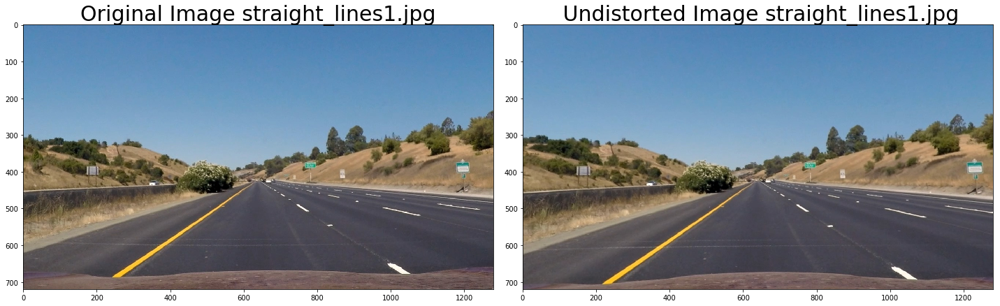

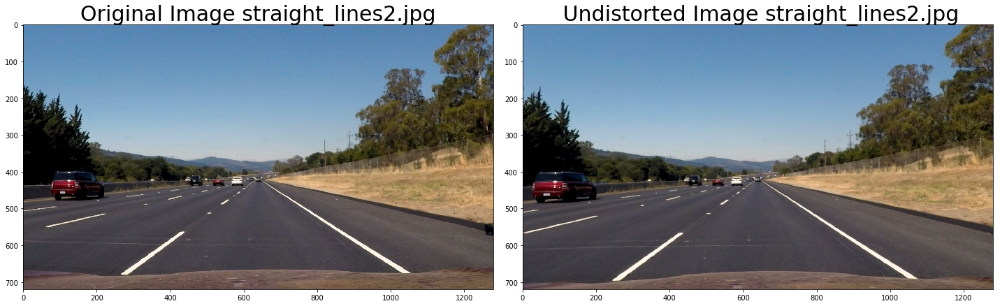

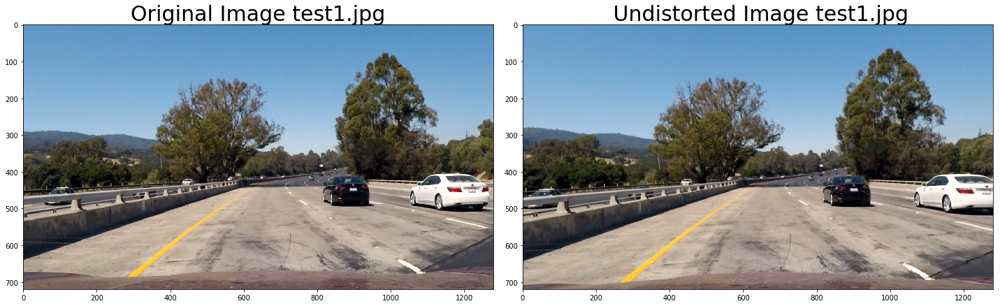

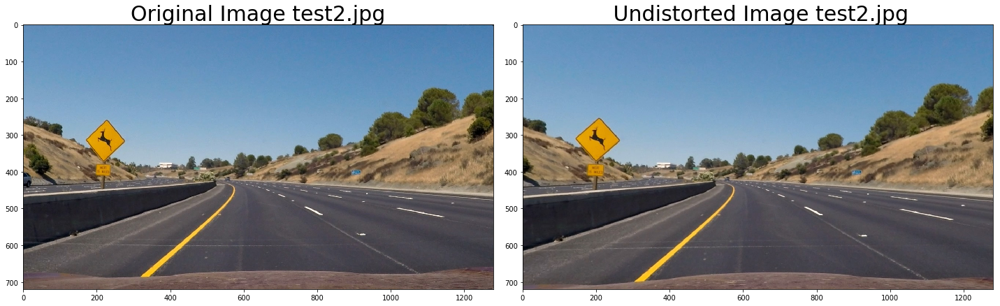

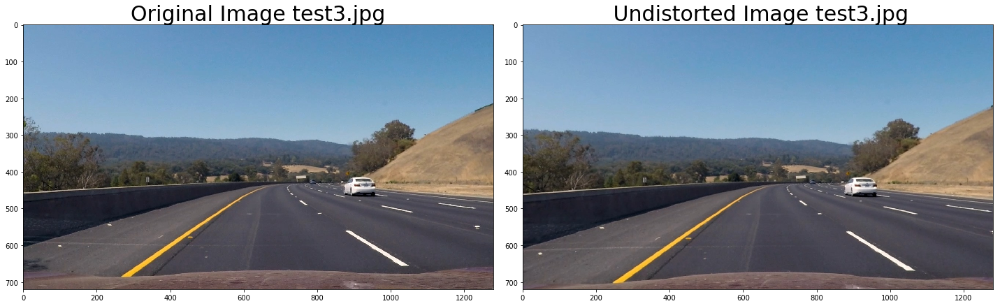

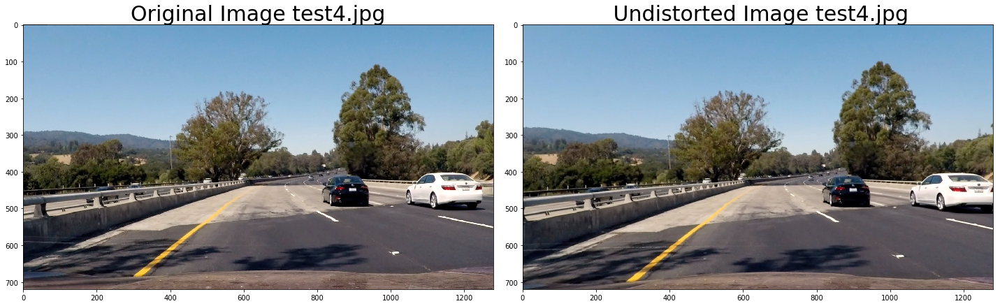

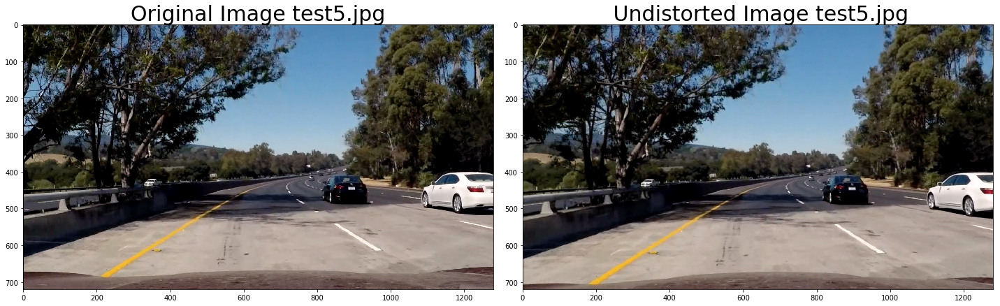

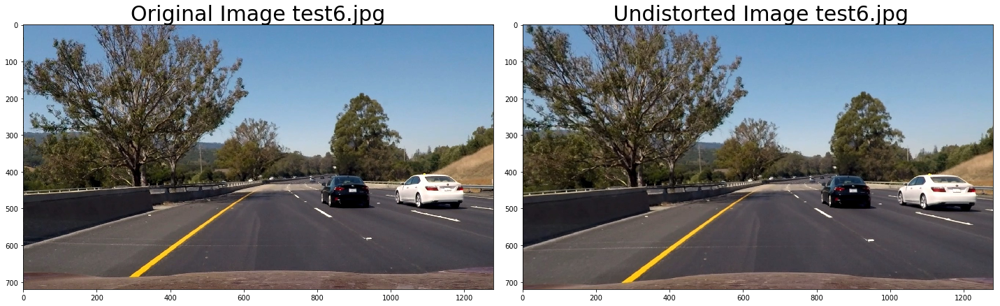

In [4]:
import os
files = os.listdir("test_images/")
print(files)
# Read saved camera calibration matrix
dist_pickle = pickle.load( open( "./camera_cal/wide_dist_pickle.p", "rb" ) )
mtx = dist_pickle["mtx"]
dist = dist_pickle["dist"]

for file in files:
    if file[0:7] != "undist_":
        img = mpimg.imread("test_images/"+file)
        # Read in the image}
        #img = cv2.imread('./test_images/test5.jpg')
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        #Apply the stored camera matrix and distortion coefficients to the read image
        undistorted = undistort(img, mtx, dist)
        #Save undistorted image
        #cv2.imwrite('./test_images/test5_undist.jpg',undistorted)
        cv2.imwrite("output_images/undist_"+file,undistorted) 
        # cv2.imwrite("test_images/output_"+file,result)import pickle
        # Plot opiginal and undistorted lane images
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
        f.tight_layout()
        b,g,r = cv2.split(img)
        img2 = cv2.merge([r,g,b])
        ax1.imshow(img2)
        ax1.set_title('Original Image ' + file, fontsize=30)
        b,g,r = cv2.split(undistorted)
        und_img = cv2.merge([r,g,b])
        ax2.imshow(und_img)
        ax2.set_title(' Undistorted Image '+ file, fontsize=30)


## Prespective Transform

Prespective Transform, birds eye view of lane  
****

undist_straight_lines1.jpg
undist_straight_lines2.jpg
undist_test1.jpg
undist_test2.jpg
undist_test3.jpg
undist_test4.jpg
undist_test5.jpg
undist_test6.jpg


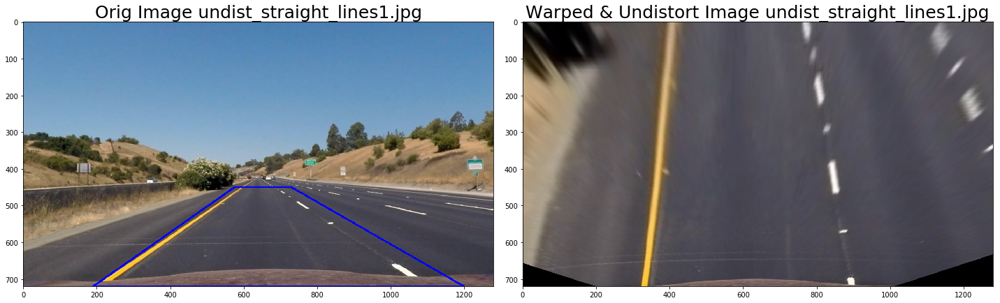

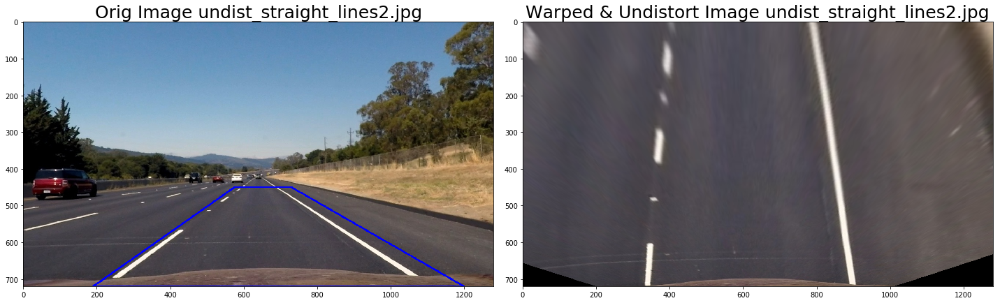

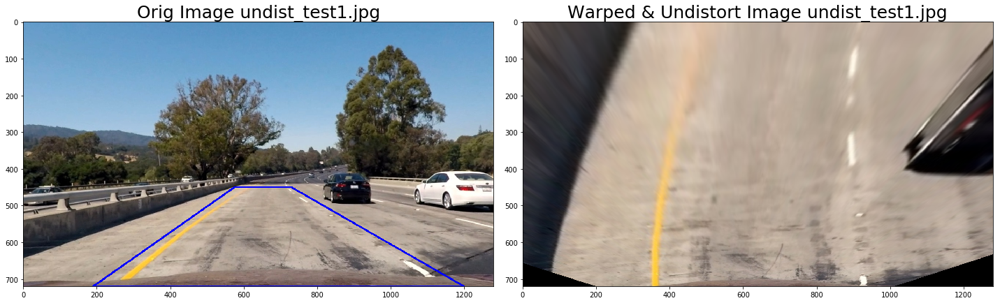

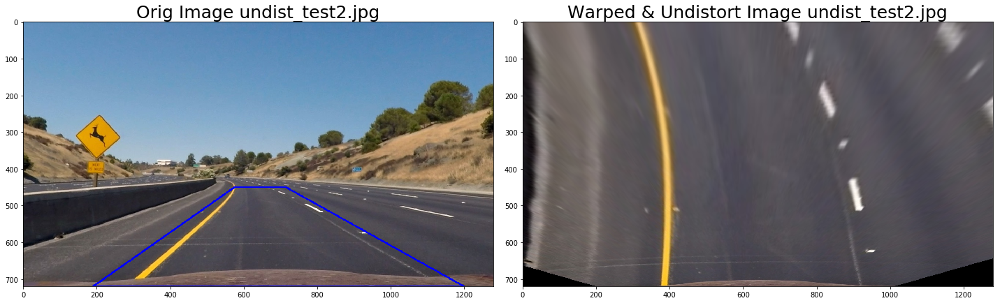

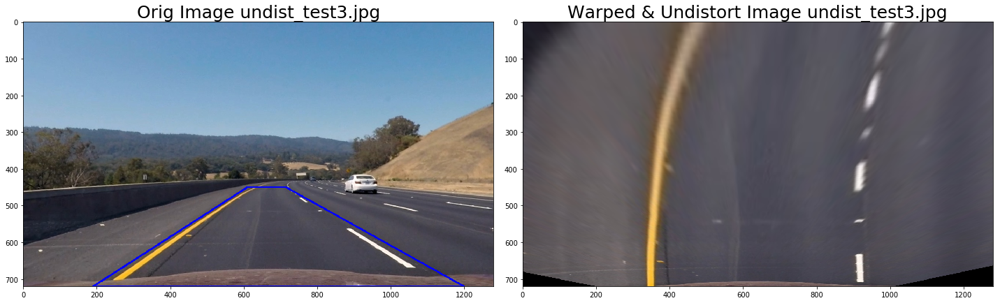

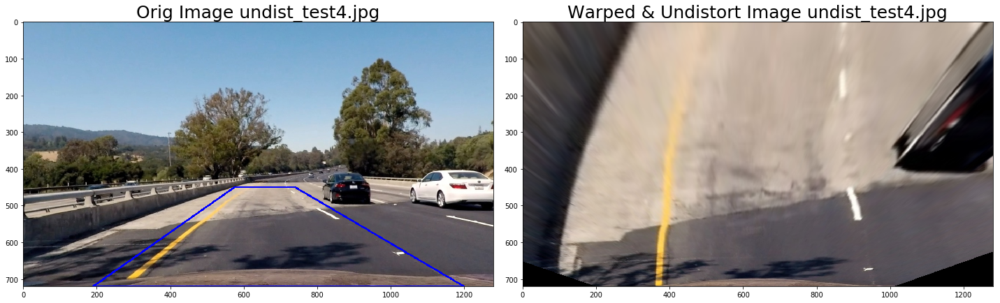

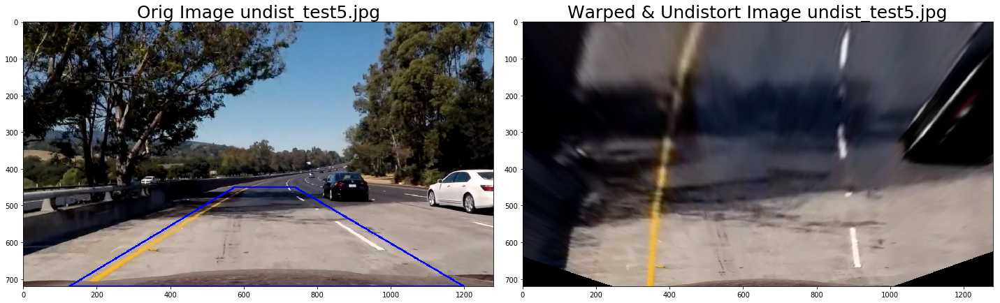

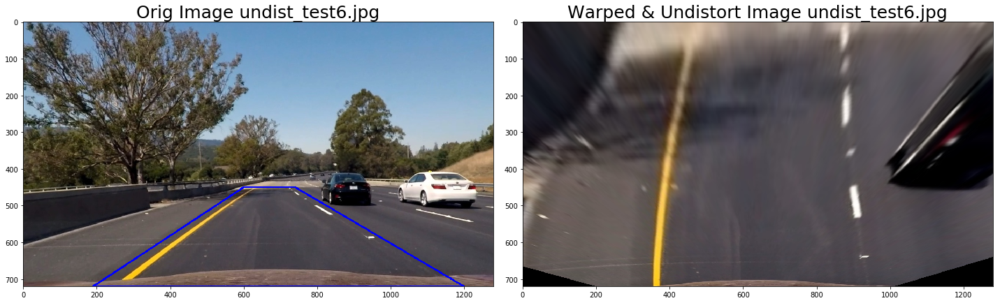

In [5]:
import os
files = os.listdir("output_images/")

#print(files)

for file in files:
        if file[0:7] == "undist_" :
            print(file)
            #img =cv2.imread("test_images/test2.jpg")
            img = mpimg.imread("output_images/"+file)
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            undistort_img = undistort(img, mtx, dist)
            #Straight lines perspective transform source points
            src=np.float32([[730,450],[1200,720],[190,720],[575,450]])  # test1
            #print(file.find('test1') )
            if file.find('test1') > 0 :
                #print(file)
                src=np.float32([[730,450],[1200,720],[190,720],[575,450]])  # test1
            if file.find('test2') > 0 :
                src=np.float32([[715,450],[1200,720],[190,720],[575,450]])   # test2
            if file.find('test3') > 0 :    
                src=np.float32([[715,450],[1200,720],[190,720],[610,450]])  # test3
            if file.find('test4') > 0 :    
                src=np.float32([[740,450],[1200,720],[190,720],[575,450]])  # test4
            if file.find('test5') > 0 :    
                src=np.float32([[740,450],[1200,720],[125,720],[575,450]])  # test5
            if file.find('test6') > 0 :    
                src=np.float32([[740,450],[1200,720],[190,720],[600,450]])  # test6
            if file.find('straightline1') > 0 :    
                src=np.float32([[710,450],[1150,720],[150,720],[575,450]])  # straightline1
            if file.find('straightline2') > 0 :    
                src=np.float32([[710,450],[1150,720],[150,720],[575,450]])  # straightline2

            #                   p3        p4          p1       p2
            # [p3] [p4] [p1] [p2]
            #  
            #      p2    ---------   p3
            #          /           \  
            # ^       /             \
            # ^      /               \
            # ^     /                 \
            # y  p1 ------------------ p4
            # x >>>>>
            #[680,450],[1100,720],[190,720],[600,450]]
            corner_tuples=[] 
            for ind,c in enumerate(src):    
                corner_tuples.append(tuple(src[ind]))
            cv2.line(img, corner_tuples[0], corner_tuples[1], color=[255,0,0], thickness=3)
            cv2.line(img, corner_tuples[1], corner_tuples[2], color=[255,0,0], thickness=3)
            cv2.line(img, corner_tuples[2], corner_tuples[3], color=[255,0,0], thickness=3)
            cv2.line(img, corner_tuples[3], corner_tuples[0], color=[255,0,0], thickness=3)
    
            imshape = img.shape         
            warp_img,Minv=persp_transform(undistort_img, src)
            #plt.imshow(warp_img)
            #Save undistorted and warped image
            #cv2.imwrite('./test_images/warp_test2.jpg',warp_img)
            cv2.imwrite("output_images/warped_"+file,warp_img)

            f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
            f.tight_layout()
            b,g,r = cv2.split(warp_img)
            warp_img = cv2.merge([r,g,b])
            b,g,r = cv2.split(img)
            img = cv2.merge([r,g,b])
            ax1.imshow(img)
            ax1.set_title('Orig Image ' + file, fontsize=25)
            ax2.imshow(warp_img)
            ax2.set_title('Warped & Undistort Image '+ file, fontsize=25)



## Lane Line Visualization, color and gradient threshold

  
****

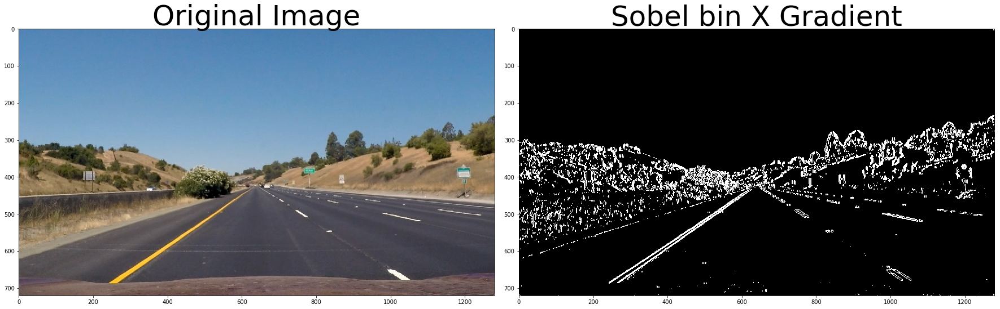

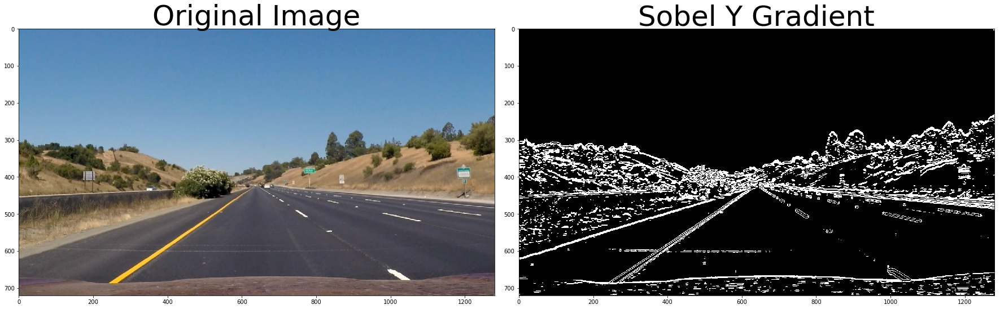

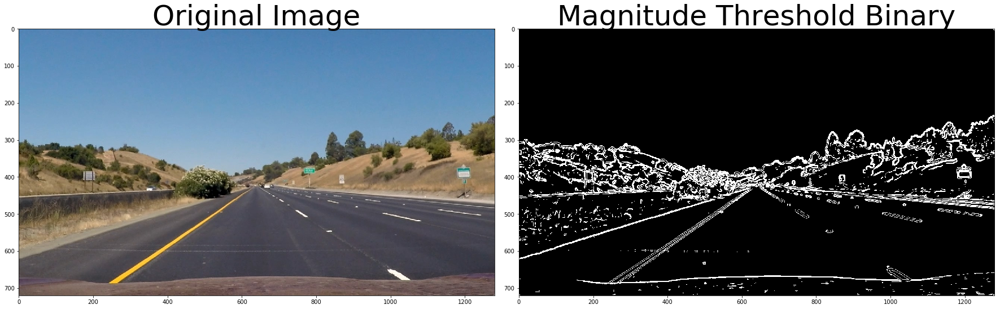

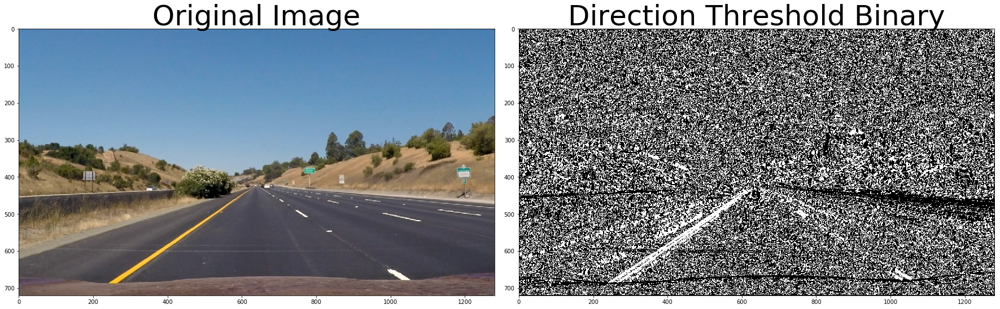

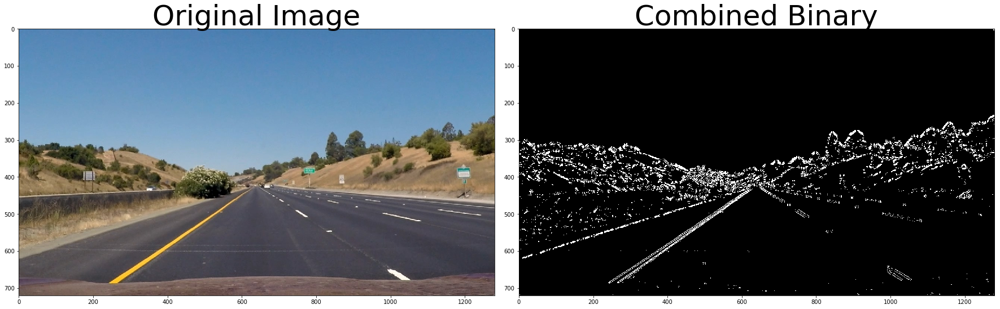

...

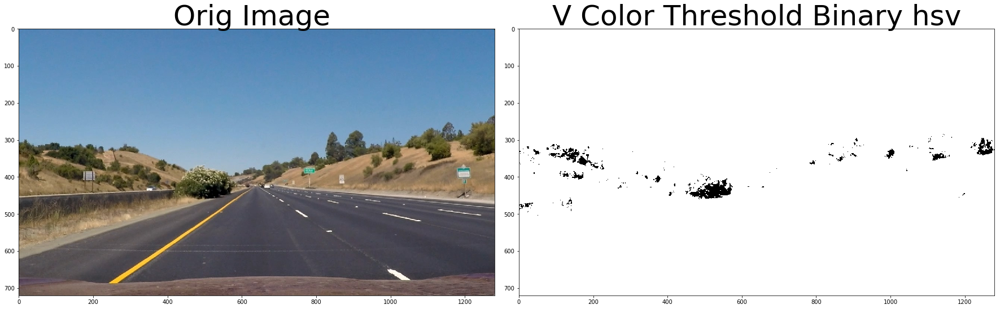

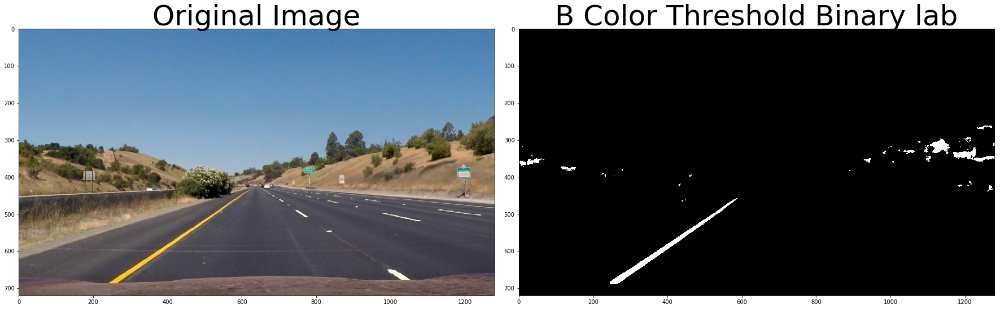

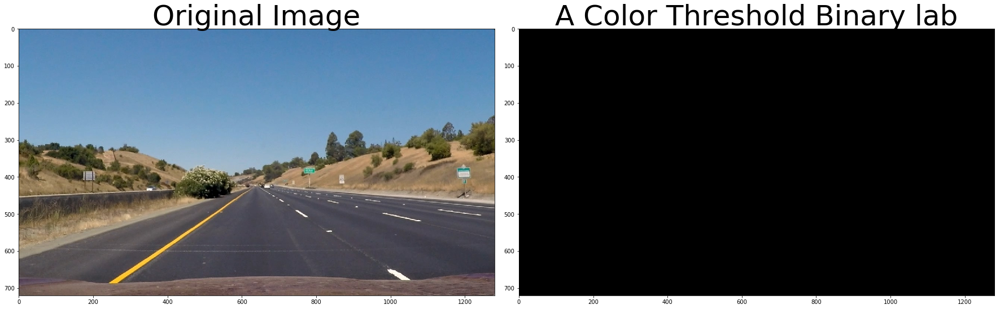

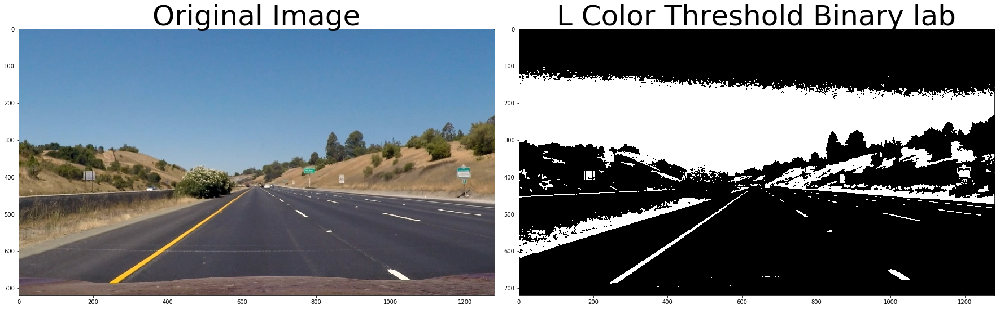

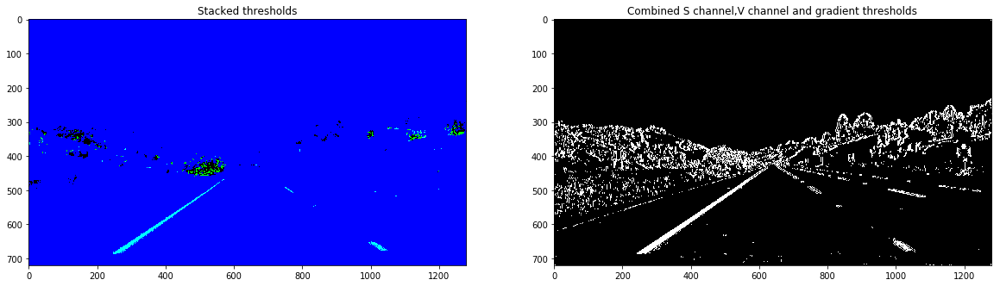

In [7]:
import os
files = os.listdir("test_images/")

#print(files)

#for file in files:
#if file[0:6] != "output":

img = cv2.imread('./test_images/straight_lines1.jpg')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# Kernel
kernel = 9

#Binary along x, y  dir
bin_x = abs_sobel_thresh(img, orient='x', thresh_min=20, thresh_max=100,sobel_kernel=kernel)
bin_y = abs_sobel_thresh(img, orient='y', thresh_min=20, thresh_max=100,sobel_kernel=kernel)

# Mag Thres
mag_bin = mag_thresh(img, sobel_kernel=kernel, mag_thresh=(30, 100))

# Dir Thres
dir_bin = dir_threshold(img, sobel_kernel=kernel, thresh=(0.7, 1.3)) 

# Color Thres
hls_bin_H = hls_select(img,chan='H',thresh=(150, 255))
hls_bin_L = hls_select(img,chan='L',thresh=( 40, 255))
hls_bin_S = hls_select(img,chan='S',thresh=(170, 255))

# Color LUV thres
hsv_bin_H = hsv_select(img,chan='H',thresh=(225, 255))
hsv_bin_S = hsv_select(img,chan='S',thresh=(170, 255))
hsv_bin_V = hsv_select(img,chan='V',thresh=( 50, 255))

# Color Thres using LAB
lab_bin_L = lab_select(img,chan='L',thresh=(150, 255))
lab_bin_A = lab_select(img,chan='A',thresh=(150, 255))
lab_bin_B = lab_select(img,chan='B',thresh=(155, 255))

# Combine the above thres
comb = np.zeros_like(dir_bin)
comb[((bin_x == 1) & (bin_y == 1)) | ((mag_bin == 1) & (dir_bin == 1))] = 1

# stack for contributions green and blue
color_bin = np.dstack(( np.zeros_like(bin_x), hls_bin_S, hsv_bin_V)) * 255

# Combine s and X thres
comb_bin = np.zeros_like(bin_x)
comb_bin[(((hls_bin_S == 1) & ((hls_bin_L == 1)))  | (bin_x == 1))] = 1


# Sobel
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(bin_x, cmap='gray')
ax2.set_title('Sobel bin X Gradient', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.0)

# Visualize Sobel y
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(bin_y, cmap='gray')
ax2.set_title('Sobel Y Gradient', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

#Visualize Magnitude Threshold
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(mag_bin, cmap='gray')
ax2.set_title('Magnitude Threshold Binary', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

#Visualize Magnitude Threshold
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(dir_bin, cmap='gray')
ax2.set_title('Direction Threshold Binary', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

#Visualize Combined Threshold
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(comb, cmap='gray')
ax2.set_title('Combined Binary', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

#Visualize H Color Threshold
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(hls_bin_H, cmap='gray')
ax2.set_title('H Color Threshold Binary hls', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

#Visualize L Color Threshold
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(hls_bin_L, cmap='gray')
ax2.set_title('L Color Threshold Binary hls', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

#Visualize S color Threshold
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(hls_bin_S, cmap='gray')
ax2.set_title('S Color Threshold Binary hls', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

#Visualize L color Threshold
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(hsv_bin_H, cmap='gray')
ax2.set_title('H Color Threshold Binary hsv', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

#Visualize U color Threshold
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(hsv_bin_S, cmap='gray')
ax2.set_title('S Color Threshold Binary hsv', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

#Visualize V color Threshold
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Orig Image ', fontsize=50)
ax2.imshow(hsv_bin_V, cmap='gray')
ax2.set_title('V Color Threshold Binary hsv', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

#Visualize B color Threshold
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(lab_bin_B, cmap='gray')
ax2.set_title('B Color Threshold Binary lab', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

#Visualize A color Threshold
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(lab_bin_A, cmap='gray')
ax2.set_title('A Color Threshold Binary lab', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

#Visualize L color Threshold
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(lab_bin_L, cmap='gray')
ax2.set_title('L Color Threshold Binary lab', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

# Plotting thresholded images
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
ax1.set_title('Stacked thresholds')
ax1.imshow(color_bin)
ax2.set_title('Combined S channel,V channel and gradient thresholds')
ax2.imshow(comb_bin, cmap='gray')

#r,g,b = cv2.split(result)
#result =cv2.merge((b,g,r))
#cv2.imwrite("output_images/output_"+file,result)



## Lane Detection



test6.jpg


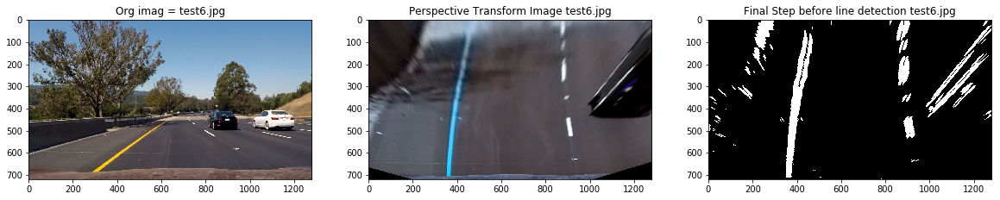

In [8]:
import os
# Choose an image to identify Lane lines
files = os.listdir("test_images/")
file ="test6.jpg"
#for file in files:
print(file)
#img =cv2.imread("test_images/test6.jpg")
img = mpimg.imread("test_images/"+file)


img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

#Load Camera coeffecients
dist_pickle = pickle.load( open( "./camera_cal/wide_dist_pickle.p", "rb" ) )
mtx = dist_pickle["mtx"]
dist = dist_pickle["dist"]

#Apply the stored camera matrix and distortion coefficients to the read image
undistort_img = undistort(img, mtx, dist)

# Color and Gradient Thresholding
kernel=9
soblelx_thresh =(20,255)
hls_s_thresh =(120,255)
lab_b_thresh =(155,225)
lab_l_thresh=(40,255)
bin=bin_threshold(undistort_img,kernel=kernel,binx_thresh=soblelx_thresh,s_thresh=hls_s_thresh,b_thresh=lab_b_thresh,l_thresh=lab_l_thresh)


#Perspective Transform
if file.find('test1') > 0 :
    src=np.float32([[730,450],[1200,720],[190,720],[575,450]])  # test1
if file.find('test2') > 0 :
    src=np.float32([[715,450],[1200,720],[190,720],[575,450]])   # test2
if file.find('test3') > 0 :    
    src=np.float32([[715,450],[1200,720],[190,720],[610,450]])  # test3
if file.find('test4') > 0 :    
    src=np.float32([[740,450],[1200,720],[190,720],[575,450]])  # test4
if file.find('test5') > 0 :    
    src=np.float32([[740,450],[1200,720],[125,720],[575,450]])  # test5
if file.find('test6') > 0 :
    print(file)
    src=np.float32([[740,450],[1200,720],[190,720],[600,450]])  # test6
if file.find('straightline1') > 0 :    
    src=np.float32([[710,450],[1150,720],[150,720],[575,450]])  # straightline1
if file.find('straightline2') > 0 :    
    src=np.float32([[710,450],[1150,720],[150,720],[575,450]])  # straightline2
                
                
#                   p3        p4          p1       p2
# [p3] [p4] [p1] [p2]
#  
#      p2    ---------   p3
#          /           \  
# ^       /             \
# ^      /               \
# ^     /                 \
# y  p1 ------------------ p4
# x >>>>>
# image coords

source=src
pers_bin_img,Minv=persp_transform(bin,source)
warp_img,Minv=persp_transform(img,source)

# plot
# Plotting thresholded images
f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(20,10))
name= "Org imag = "+ file
#print(name)
ax1.set_title(name)
b,g,r = cv2.split(img)
img = cv2.merge([r,g,b])
ax1.imshow(img)
ax2.set_title('Perspective Transform Image ' + file)
ax2.imshow(warp_img)
ax3.set_title('Final Step before line detection ' + file)
ax3.imshow(pers_bin_img, cmap='gray')

 
#plot= True
#left_fit, right_fit, left_lane_inds, right_lane_inds, histogram = sliding_window_polyfit(pers_bin_img,plot)    
                
#cv2.imwrite("output_images/warped_"+file,warp_img)            

## Sliding Window



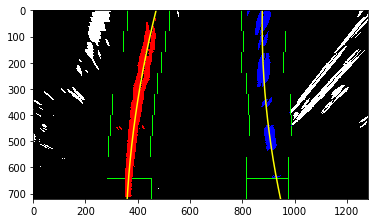

In [9]:
plot= True
left_fit, right_fit, left_lane_inds, right_lane_inds, histogram = sliding_window_polyfit(pers_bin_img,plot)


## Histogram



(0, 1280)

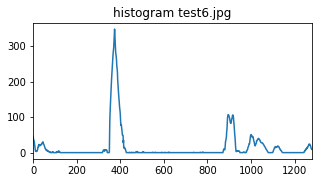

In [10]:
# Print histogram from sliding window polyfit for example image
f, (ax1) = plt.subplots(1, 1, figsize=(5,2.5))
ax1.set_title('histogram ' + file)
plt.plot(histogram)

plt.xlim(0, 1280)

## Curvature



In [11]:
# radius of curvature
left_curv, right_curv, cent_dist = rad_curvature(pers_bin_img, left_fit, right_fit, left_lane_inds, right_lane_inds)

print('Radius of curvature for example:', left_curv, 'm,', right_curv, 'm')
print('Distance from lane center for example:', cent_dist, 'm')


Radius of curvature for example: 1237.3797806702942 m, 1033.5032284709991 m
Distance from lane center for example: -0.06848398670925986 m


## On Lane



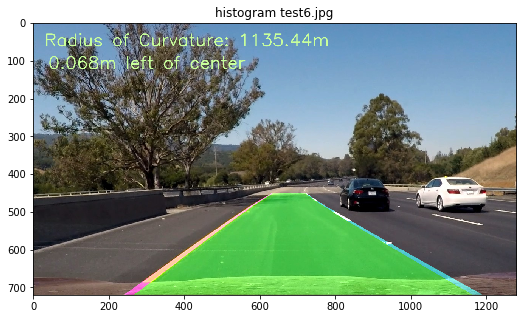

In [12]:
output = draw_lane(img, pers_bin_img, left_fit, right_fit, Minv,left_curv,right_curv,cent_dist)
f, (ax1) = plt.subplots(1, figsize=(10,5))  
ax1.set_title('histogram ' + file)
plt.imshow(output)

## Using Previous Frame



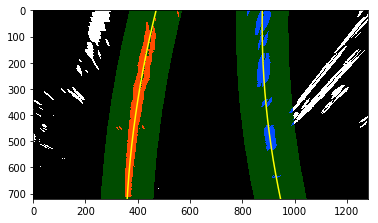

In [13]:
plot=True
left_fit_new, right_fit_new, left_lane_inds, right_lane_inds=polyfit_prevfit(pers_bin_img, left_fit, right_fit,plot)

## Lane Finding Pipeline all images 



['straight_lines1.jpg', 'straight_lines2.jpg', 'test1.jpg', 'test2.jpg', 'test3.jpg', 'test4.jpg', 'test5.jpg', 'test6.jpg']


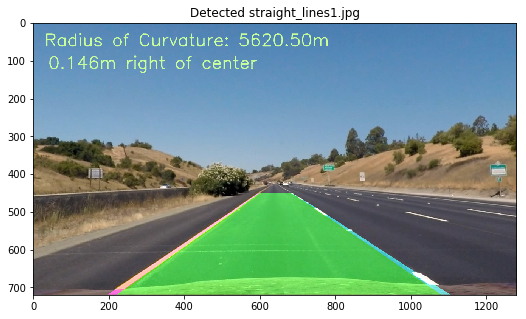

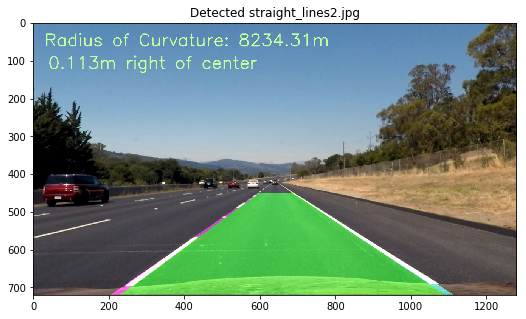

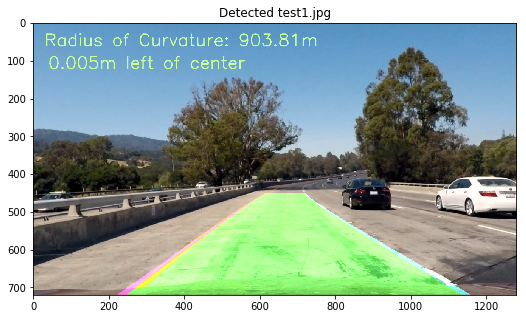

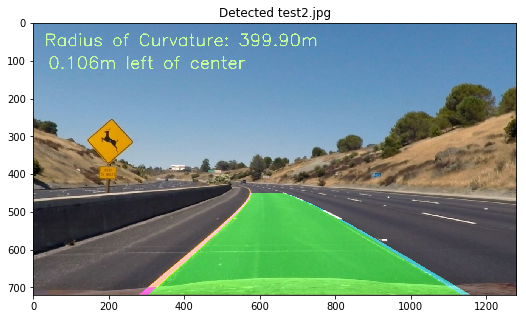

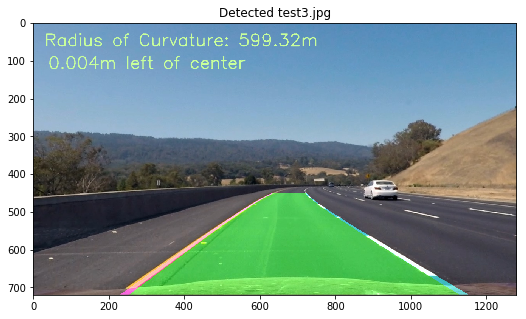

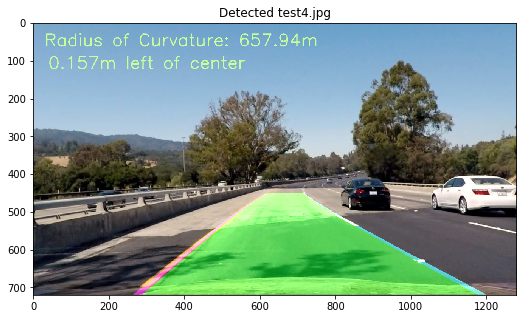

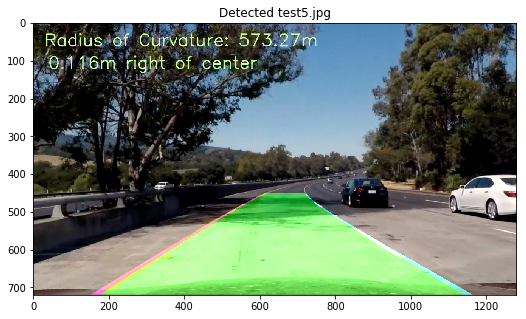

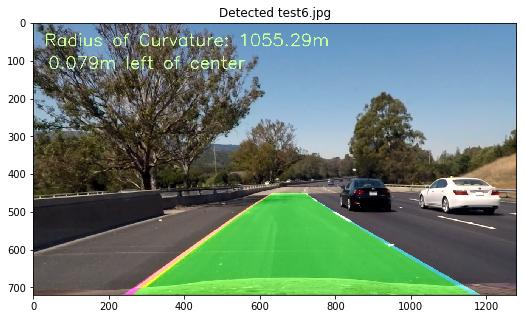

In [14]:
import os
# Choose an image to identify Lane lines
files = os.listdir("test_images/")
print(files)
for file in files:

    # Call the pipeline image with each image in the test_images folder
    #img = cv2.imread('./test_images/test6.jpg')
    img = mpimg.imread("test_images/"+file)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    proc_img=process_image(img)
    proc_img = cv2.cvtColor(proc_img, cv2.COLOR_BGR2RGB)
    
    #plt.imshow(proc_img)
    #Save Lane detected 
    proc_img = cv2.cvtColor(proc_img, cv2.COLOR_BGR2RGB)
    cv2.imwrite("output_images/detect_"+file,proc_img)
    
    #
    proc_img = cv2.cvtColor(proc_img, cv2.COLOR_BGR2RGB)
    f, (ax1) = plt.subplots(1, figsize=(10,5))  
    ax1.set_title('Detected ' + file)
    plt.imshow(proc_img)
    

## Videos



In [15]:
# Define Class to store last few detected left and right lane lines
class Lane_Lines():
    def __init__(self):
        # was the line detected in the last iteration
        self.detected = False  
        self.old_fits = []
        self.best_fit=None
        self.diff = np.array([0,0,0], dtype='float') 
    def detect_fit(self,new_fit):
        if new_fit is not None:
            if self.best_fit is not None:
                # if we have a best fit, see how this new fit compares
                self.diff = abs(new_fit-self.best_fit)
            if (self.diff[0] > 0.001 or self.diff[1] > 1.0 or self.diff[2] > 100.):
                # bad fit! abort! abort! 
                self.detected = False
            else:
                self.detected = True
                self.old_fits.append(new_fit)
                if len(self.old_fits) > 5:
                    self.old_fits = self.old_fits[len(self.old_fits)-5:]
                self.best_fit = np.average(self.old_fits, axis=0)
        else:
            self.detected = False


In [16]:
def process_video(image):
    #Completing the entire image processing pipeline for a particular frame
    #Read in Camera Calibration Matrix
    dist_pickle = pickle.load( open( "./camera_cal/wide_dist_pickle.p", "rb" ) )
    mtx = dist_pickle["mtx"]
    dist = dist_pickle["dist"]
    
    #Undistort after converstion to RGB
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    undistort_img = undistort(image, mtx, dist)

    # Color and Gradient Thresholding
    kernel=9
    soblelx_thresh =(20,255)
    hls_s_thresh =(120,255)
    lab_b_thresh =(155,225)
    lab_l_thresh=(40,255)
    binary=bin_threshold(undistort_img,kernel=kernel,binx_thresh=soblelx_thresh,s_thresh=hls_s_thresh,b_thresh=lab_b_thresh,l_thresh=lab_l_thresh)
    
    #Perspective Transform
    source=np.float32([[710,450],[1150,720],[230,720],[600,450]])#Test 1 image
    pers_bin_img,Minv=persp_transform(binary,source)
    warp_img,Minv=persp_transform(img,source)
  
    ## Recognizing lane lines through sliding window implementation
    plot=False
    if not left.detected or not right.detected:
        left_fit, right_fit, left_lane_inds, right_lane_inds, histogram = sliding_window_polyfit(pers_bin_img,plot)
    else:
        left_fit, right_fit, left_lane_inds, right_lane_inds=polyfit_prevfit(pers_bin_img, left.best_fit, right.best_fit,plot)
   
    left.detect_fit(left_fit)
    right.detect_fit(right_fit)
       
    #Determine radius of curvature
    left_curv, right_curv, cent_dist = rad_curvature(pers_bin_img, left.best_fit, right.best_fit, left_lane_inds, right_lane_inds)
    #Draw the lane lines and output radius of curvature information on image
    result = draw_lane(undistort_img, pers_bin_img, left.best_fit,right.best_fit, Minv,left_curv,right_curv,cent_dist) 
    result = cv2.cvtColor(result, cv2.COLOR_BGR2RGB)
    #Draw the lane lines and output radius of curvature information on image
    return result

In [17]:
# Import everything needed to edit/save/watch video cl}ips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

In [18]:
left=Lane_Lines()
right=Lane_Lines()


video_output = 'Output_project_video.mp4'

clip1 = VideoFileClip("project_video.mp4")
#clip1 = VideoFileClip("test_videos/solidWhiteRight.mp4")
white_clip = clip1.fl_image(process_video) #
%time white_clip.write_videofile(video_output, audio=False)

[MoviePy] >>>> Building video Output_project_video.mp4
[MoviePy] Writing video Output_project_video.mp4


100%|█████████████████████████████████████▉| 1260/1261 [03:07<00:00,  6.38it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: Output_project_video.mp4 

Wall time: 3min 9s


In [19]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(video_output))